**In case of problems or questions, please first check the list of [Frequently Asked Questions (FAQ)](https://stardist.net/docs/faq.html).**

Please shutdown all other training/prediction notebooks before running this notebook (as those might occupy the GPU memory otherwise).

In [1]:
from __future__ import print_function, unicode_literals, absolute_import, division
import sys
import numpy as np
import matplotlib
matplotlib.rcParams["image.interpolation"] = 'nearest'
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

from glob import glob
from tifffile import imread
from csbdeep.utils import Path, normalize
from csbdeep.io import save_tiff_imagej_compatible

from stardist import random_label_cmap
from stardist.models import StarDist3D

np.random.seed(6)
lbl_cmap = random_label_cmap()
import os
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"


# Data

We assume that data has already been downloaded in via notebook [1_data.ipynb](1_data.ipynb).  
We now load images from the sub-folder `test` that have not been used during training.

In [2]:
X = sorted(glob('data/ctx_dapi/test/images/*quaterF*.tif'))
X = list(map(imread,X))

n_channel = 1 if X[0].ndim == 3 else X[0].shape[-1]
axis_norm = (0,1,2)   # normalize channels independently
# axis_norm = (0,1,2,3) # normalize channels jointly
if n_channel > 1:
    print("Normalizing image channels %s." % ('jointly' if axis_norm is None or 2 in axis_norm else 'independently'))

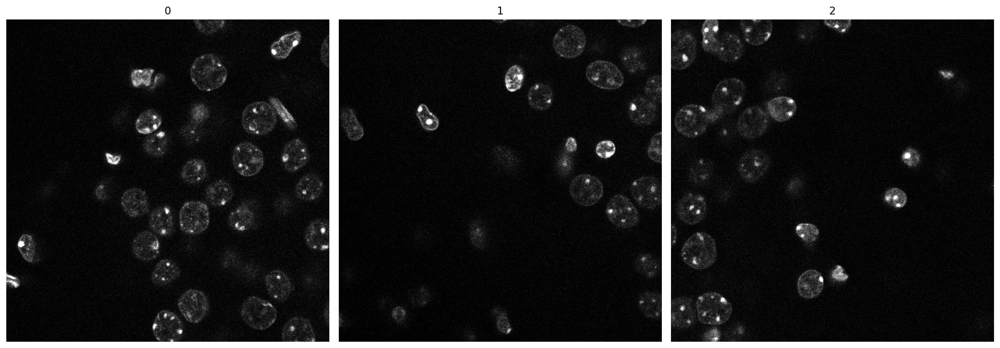

In [3]:
# show all test images
if True:
    fig, ax = plt.subplots(1,3, figsize=(16,16))
    for i,(a,x) in enumerate(zip(ax.flat, X)):
        a.imshow(x[x.shape[0]//2],cmap='gray')
        a.set_title(i)
    [a.axis('off') for a in ax.flat]
    plt.tight_layout()
None;

# Load trained model

If you trained your own StarDist model (and optimized its thresholds) via notebook [2_training.ipynb](2_training.ipynb), then please set `demo_model = False` below.

In [4]:
demo_model = False

if demo_model:
    print (
        "NOTE: This is loading a previously trained demo model!\n"
        "      Please set the variable 'demo_model = False' to load your own trained model.",
        file=sys.stderr, flush=True
    )
    model = StarDist3D.from_pretrained('3D_demo')
else:
    model = StarDist3D(None, name='stardist', basedir='models')
None;

Loading network weights from 'weights_best.h5'.
Loading thresholds from 'thresholds.json'.
Using default values: prob_thresh=0.52949, nms_thresh=0.3.


## Prediction

Make sure to normalize the input image beforehand or supply a `normalizer` to the prediction function.

Calling `model.predict_instances` will
- predict object probabilities and star-convex polygon distances (see `model.predict` if you want those)
- perform non-maximum suppression (with overlap threshold `nms_thresh`) for polygons above object probability threshold `prob_thresh`.
- render all remaining polygon instances in a label image
- return the label instances image and also the details (coordinates, etc.) of all remaining polygons

In [5]:
img = normalize(X[2], 1,99.8, axis=axis_norm)
labels, details = model.predict_instances(img)

1/1 [==============================] - 5s 5s/step


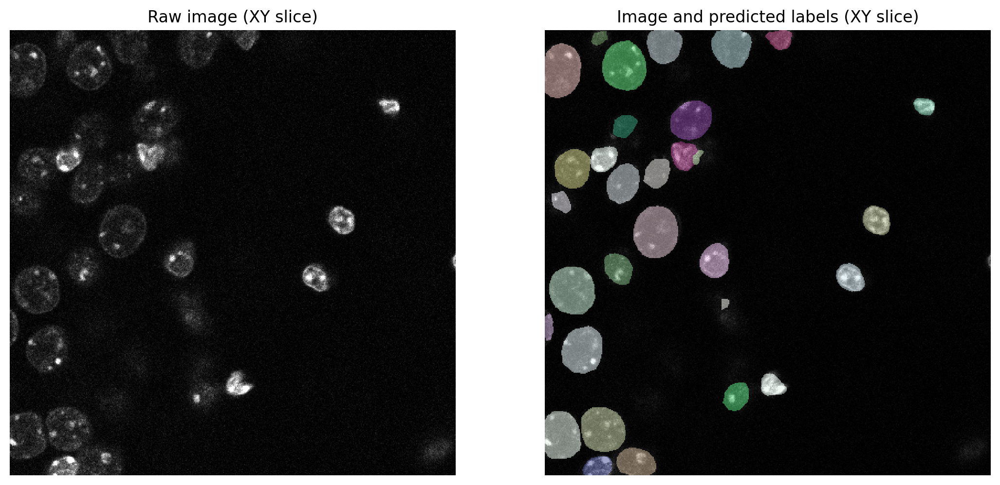

In [6]:
plt.figure(figsize=(13,10))
z = max(0, img.shape[0] // 2 - 5)
plt.subplot(121)
plt.imshow((img if img.ndim==3 else img[...,:3])[z], clim=(0,1), cmap='gray')
plt.title('Raw image (XY slice)')
plt.axis('off')
plt.subplot(122)
plt.imshow((img if img.ndim==3 else img[...,:3])[z], clim=(0,1), cmap='gray')
plt.imshow(labels[z], cmap=lbl_cmap, alpha=0.5)
plt.title('Image and predicted labels (XY slice)')
plt.axis('off');

## Save predictions

Uncomment the lines in the following cell if you want to save the example image and the predicted label image to disk.

In [7]:
# save_tiff_imagej_compatible('example_image.tif', img, axes='ZYX')
# save_tiff_imagej_compatible('example_labels.tif', labels, axes='ZYX')

# Example results

In [8]:
import skimage.io as io
root='./data/ctx_dapi/test/result/'
def example(model, i, show_dist=True):
    img = normalize(X[i], 1,99.8, axis=axis_norm)
    labels, details = model.predict_instances(img)
    io.imsave(root+str(i)+'_origin.tif',img)
    io.imsave(root+str(i)+'_predict.tif',labels)
    plt.figure(figsize=(13,8))
    z = img.shape[0] // 2
    y = img.shape[1] // 2
    img_show = img if img.ndim==3 else img[...,:3]    
    plt.subplot(221); plt.imshow(img_show[z],   cmap='gray', clim=(0,1)); plt.axis('off'); plt.title('XY slice')
    plt.subplot(222); plt.imshow(img_show[:,y], cmap='gray', clim=(0,1)); plt.axis('off'); plt.title('XZ slice')
    plt.subplot(223); plt.imshow(img_show[z],   cmap='gray', clim=(0,1)); plt.axis('off'); plt.title('XY slice')
    plt.imshow(labels[z], cmap=lbl_cmap, alpha=0.5)
    plt.subplot(224); plt.imshow(img_show[:,y], cmap='gray', clim=(0,1)); plt.axis('off'); plt.title('XZ slice')
    plt.imshow(labels[:,y], cmap=lbl_cmap, alpha=0.5)
    plt.tight_layout()
    plt.show()

In [15]:
def go(model, i, show_dist=True):
    img = normalize(X[i], 1,99.8, axis=axis_norm)
    #labels, details = model.predict_instances(img)
    plt.figure(figsize=(13,8))
    img_show = img if img.ndim==3 else img[...,:3]    
    plt.subplot(221); plt.imshow(img_show,   cmap='gray', clim=(0,1)); plt.axis('off'); plt.title('XY slice')
    plt.subplot(222); plt.imshow(img_show, cmap='gray', clim=(0,1)); plt.axis('off'); plt.title('XZ slice')
    plt.subplot(223); plt.imshow(img_show,   cmap='gray', clim=(0,1)); plt.axis('off'); plt.title('XY slice')
    plt.imshow(labels, cmap=lbl_cmap, alpha=0.5)
    plt.subplot(224); plt.imshow(img_show, cmap='gray', clim=(0,1)); plt.axis('off'); plt.title('XZ slice')
    plt.imshow(labels, cmap=lbl_cmap, alpha=0.5)
    plt.tight_layout()
    plt.show()

In [31]:
for i in X:
    print(i)


[[[  59  148  170 ...  228  320  284]
  [ 191  290  125 ...   86  312  173]
  [ 243  249  200 ...  131  260  114]
  ...
  [ 678  172  350 ...   61   10   21]
  [ 469  355  706 ...  231  103  160]
  [ 212  140  306 ...  289  247   17]]

 [[ 100   77  130 ...   18    0   32]
  [1294  147 1581 ...  640  211  319]
  [ 172  158   19 ...  531  287  408]
  ...
  [1384   95  127 ...  649  223  227]
  [  71  178   54 ...  323  661    0]
  [  63  249  379 ...  188  104   28]]

 [[ 217  155   50 ... 1543   68   79]
  [ 336  170  306 ...  251 2493  201]
  [ 271  122   40 ...  731  214  141]
  ...
  [ 254   10  121 ...  262  609  675]
  [ 287  187   96 ...  268  151  115]
  [ 252  226  199 ...  179  383  204]]

 ...

 [[1278  207  157 ...  261  519  210]
  [ 225  459  539 ...    7  123   17]
  [ 161  200 1126 ...  321 2259  170]
  ...
  [ 205  192  319 ...   46   45   85]
  [ 201  554  110 ...  281  255  449]
  [  75   96  126 ...  145   34  201]]

 [[ 366  776   89 ...  109  176  344]
  [  63 2082

1/1 [==============================] - 0s 149ms/step


4043251271.py (7): ./data/ctx_dapi/test/result/0_predict.tif is a low contrast image


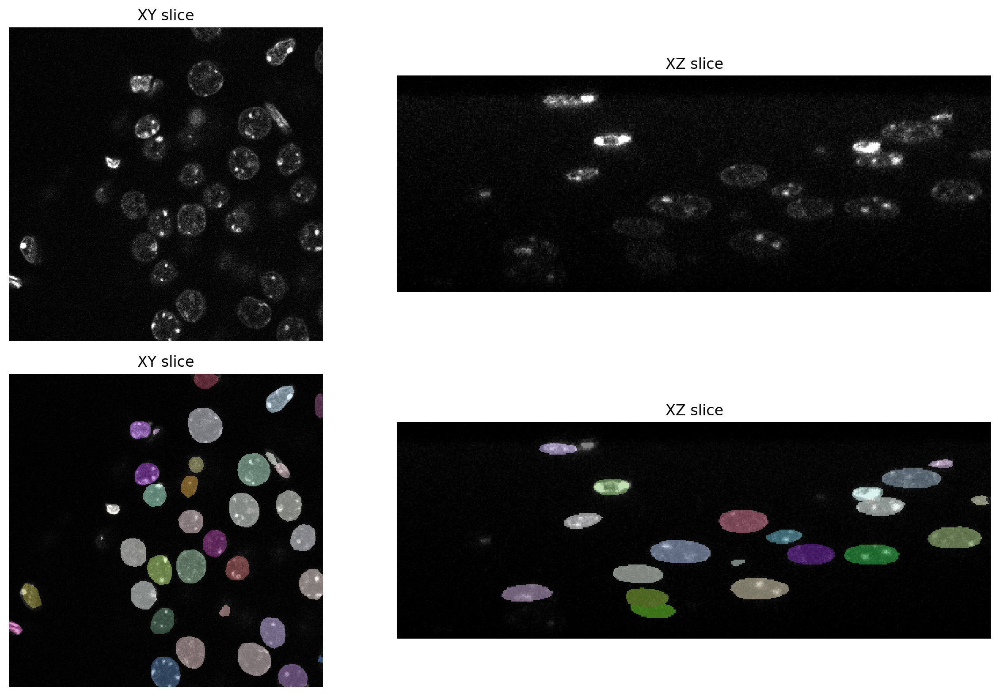

1/1 [==============================] - 0s 131ms/step


4043251271.py (7): ./data/ctx_dapi/test/result/1_predict.tif is a low contrast image


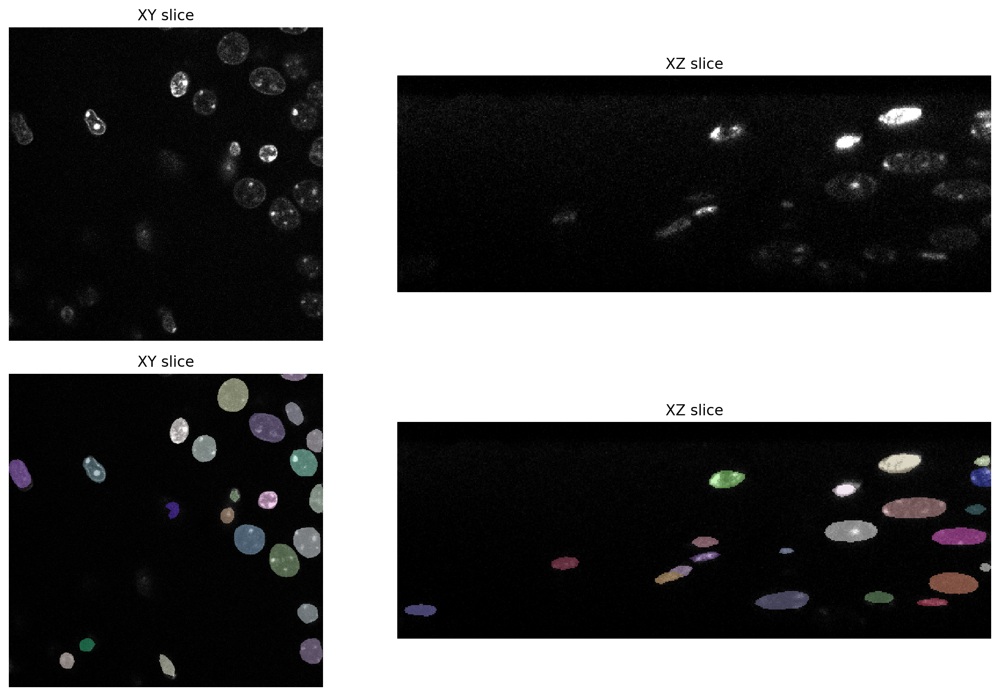

1/1 [==============================] - 0s 136ms/step


4043251271.py (7): ./data/ctx_dapi/test/result/2_predict.tif is a low contrast image


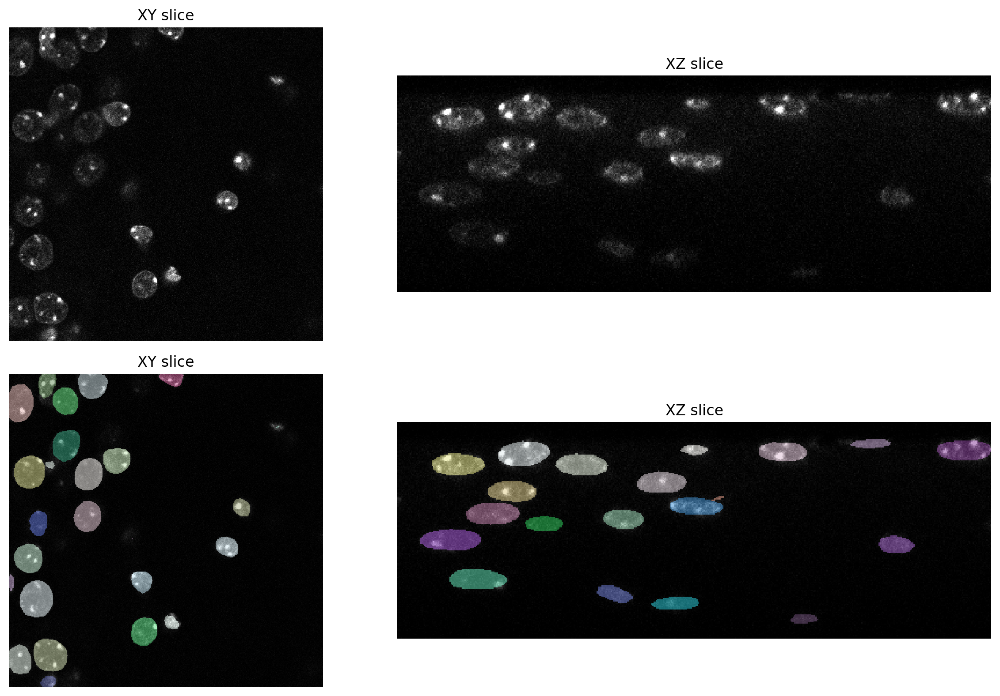

1/1 [==============================] - 0s 129ms/step


4043251271.py (7): ./data/ctx_dapi/test/result/3_predict.tif is a low contrast image


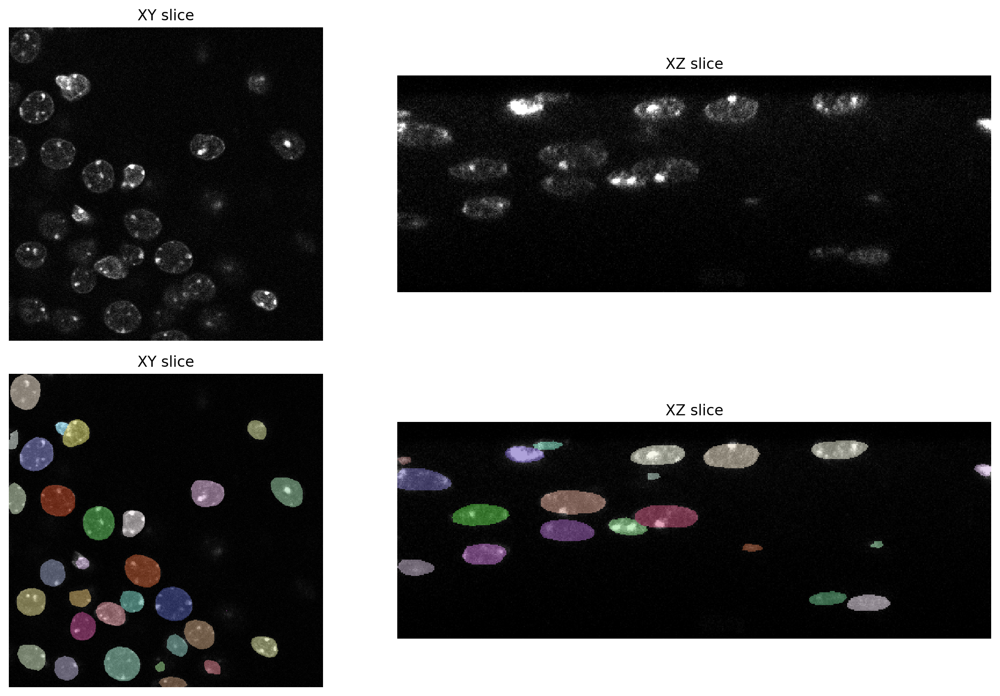

1/1 [==============================] - 3s 3s/step


4043251271.py (7): ./data/ctx_dapi/test/result/4_predict.tif is a low contrast image


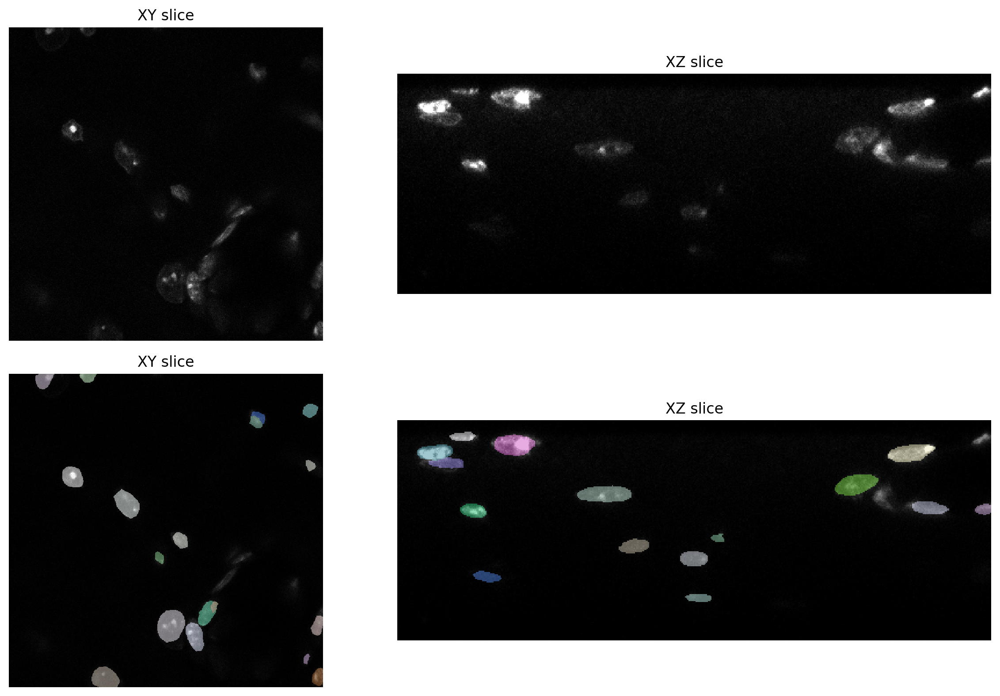

1/1 [==============================] - 0s 135ms/step


4043251271.py (7): ./data/ctx_dapi/test/result/5_predict.tif is a low contrast image


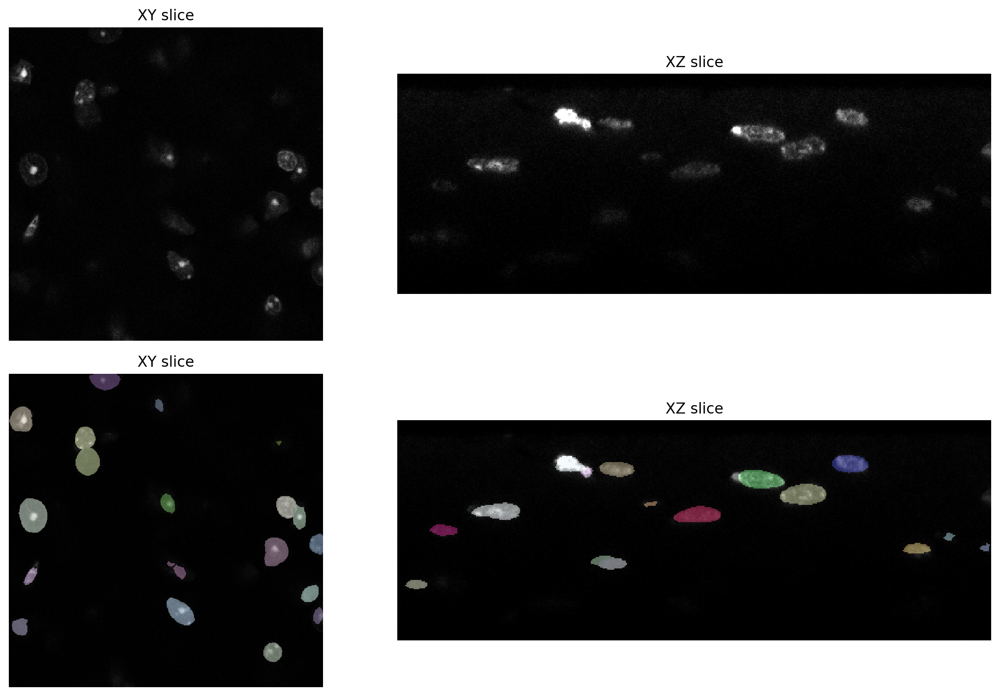

1/1 [==============================] - 0s 138ms/step


4043251271.py (7): ./data/ctx_dapi/test/result/6_predict.tif is a low contrast image


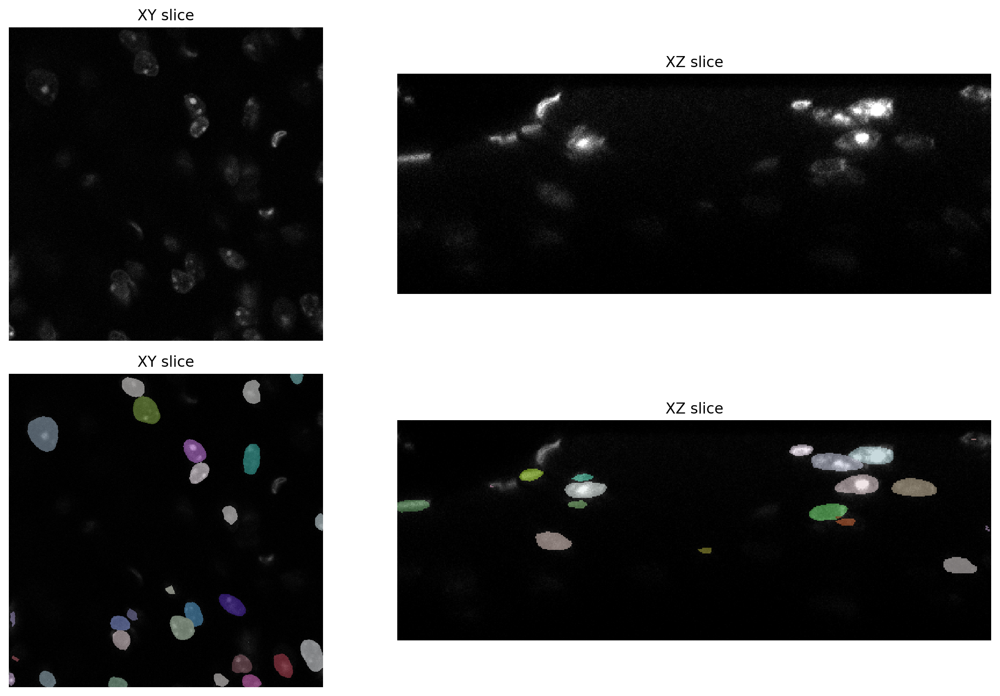

1/1 [==============================] - 0s 133ms/step


4043251271.py (7): ./data/ctx_dapi/test/result/7_predict.tif is a low contrast image


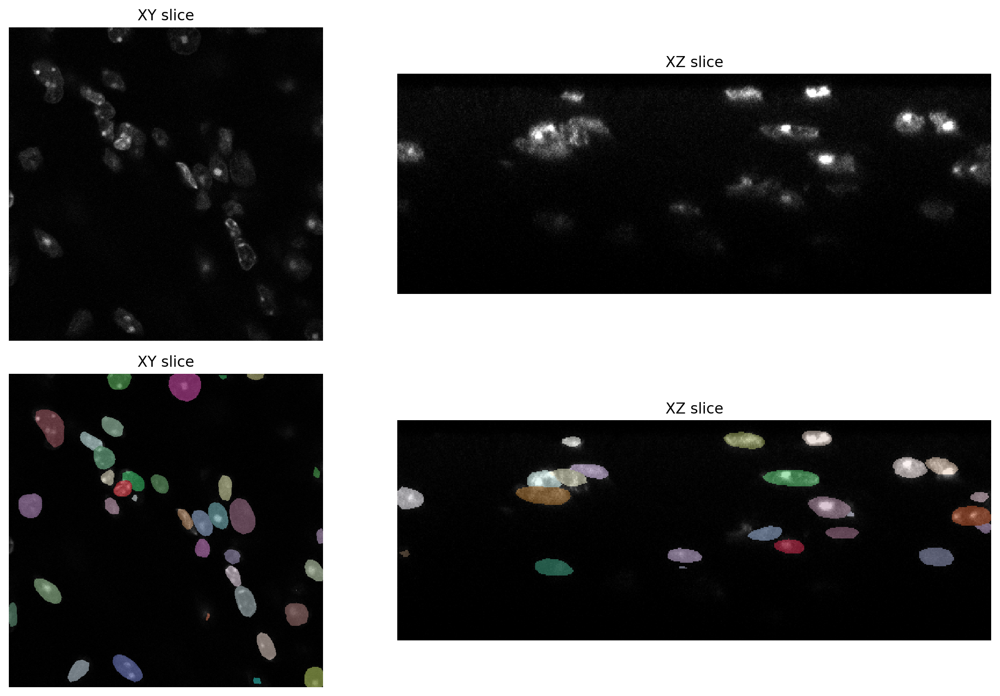

1/1 [==============================] - 0s 130ms/step


4043251271.py (7): ./data/ctx_dapi/test/result/8_predict.tif is a low contrast image


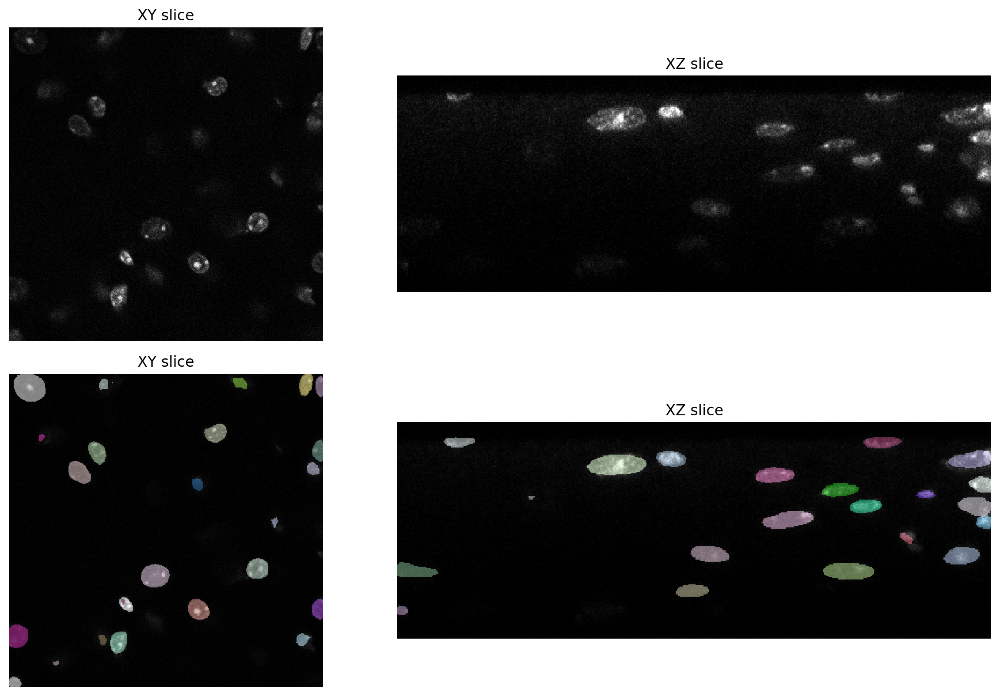

1/1 [==============================] - 0s 145ms/step


4043251271.py (7): ./data/ctx_dapi/test/result/9_predict.tif is a low contrast image


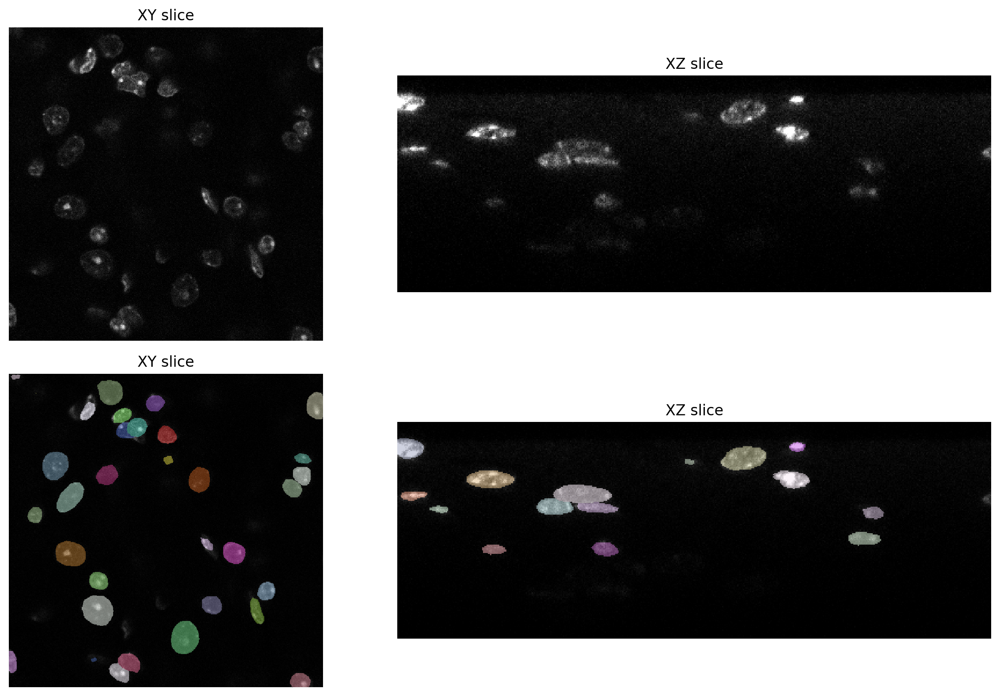

1/1 [==============================] - 0s 139ms/step


4043251271.py (7): ./data/ctx_dapi/test/result/10_predict.tif is a low contrast image


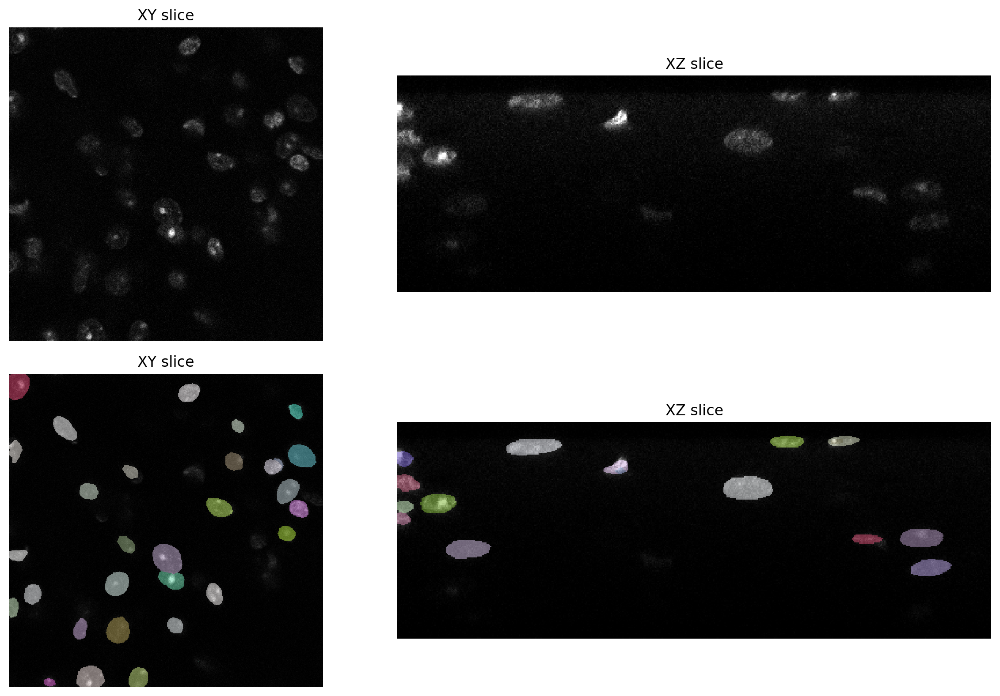

1/1 [==============================] - 0s 137ms/step


4043251271.py (7): ./data/ctx_dapi/test/result/11_predict.tif is a low contrast image


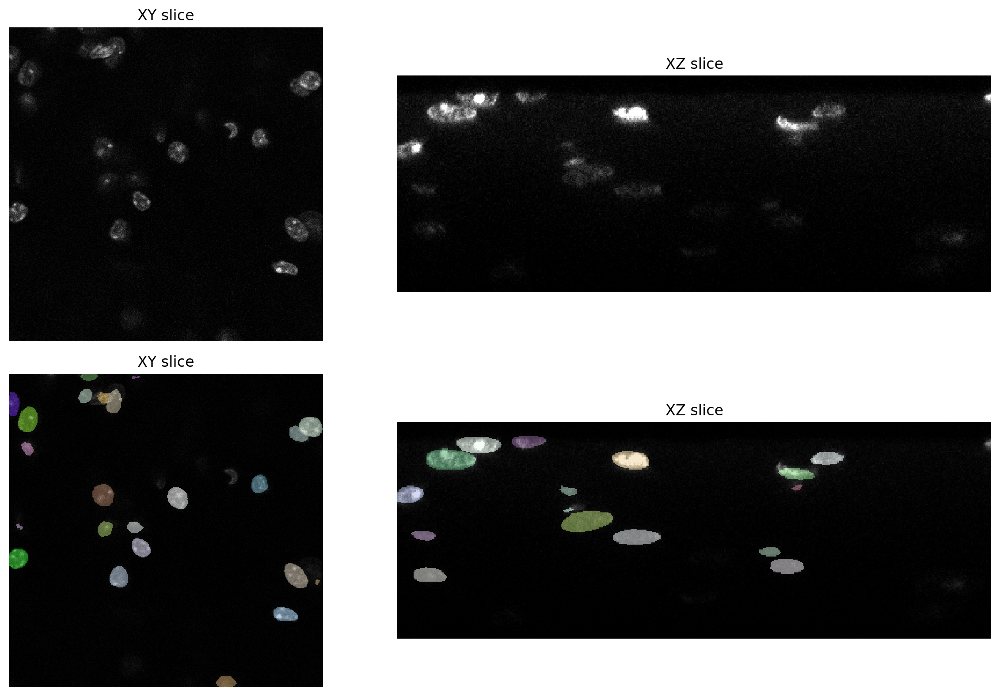

1/1 [==============================] - 3s 3s/step


4043251271.py (7): ./data/ctx_dapi/test/result/12_predict.tif is a low contrast image


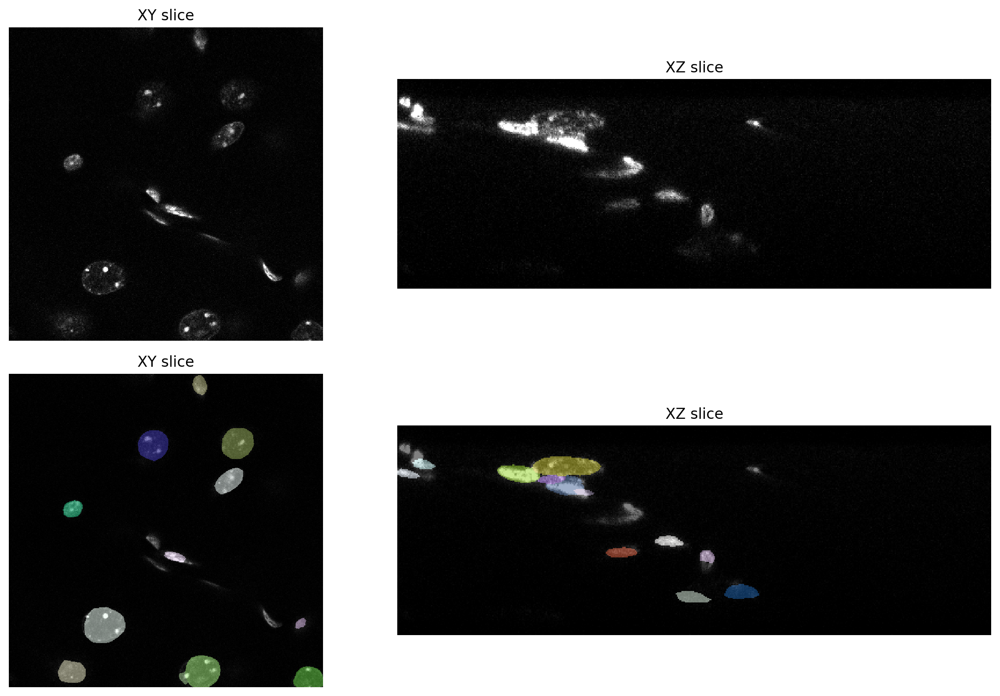

1/1 [==============================] - 0s 154ms/step


4043251271.py (7): ./data/ctx_dapi/test/result/13_predict.tif is a low contrast image


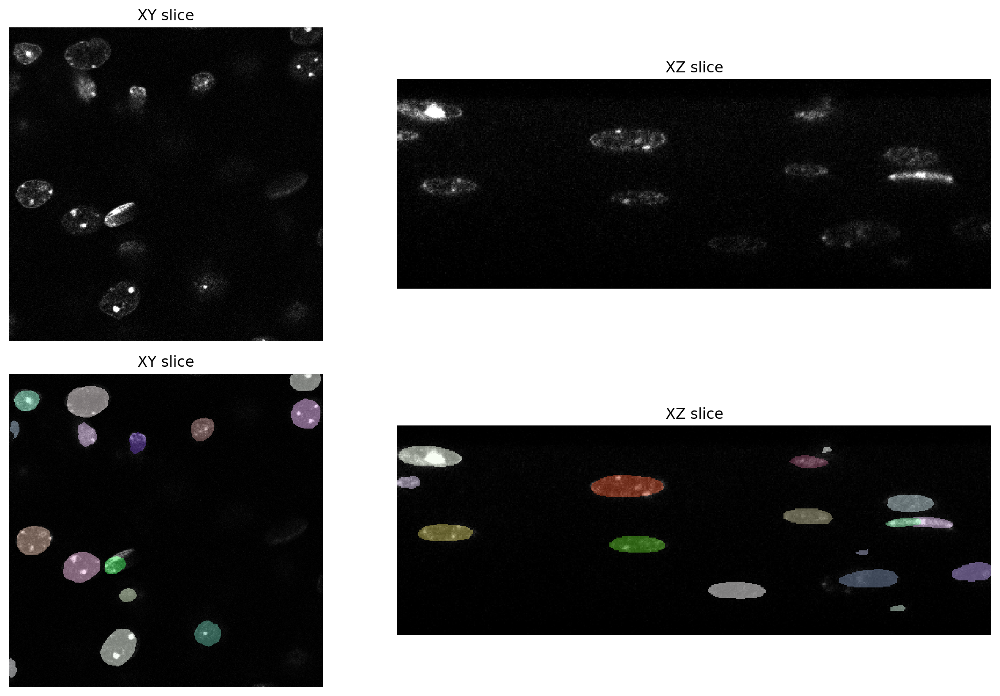

1/1 [==============================] - 0s 149ms/step


4043251271.py (7): ./data/ctx_dapi/test/result/14_predict.tif is a low contrast image


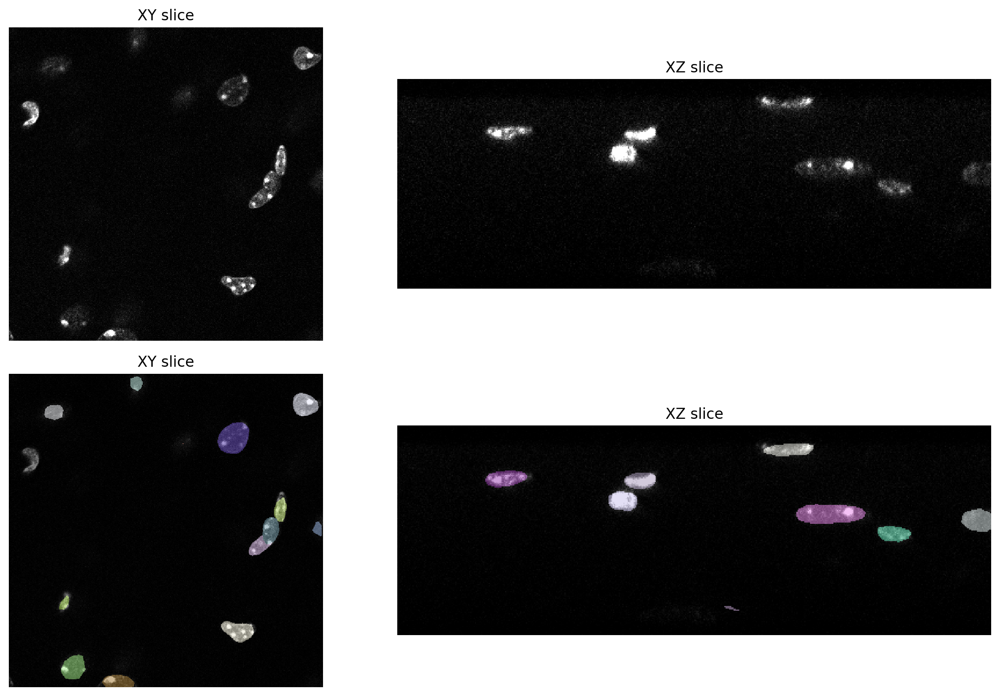

1/1 [==============================] - 0s 119ms/step


4043251271.py (7): ./data/ctx_dapi/test/result/15_predict.tif is a low contrast image


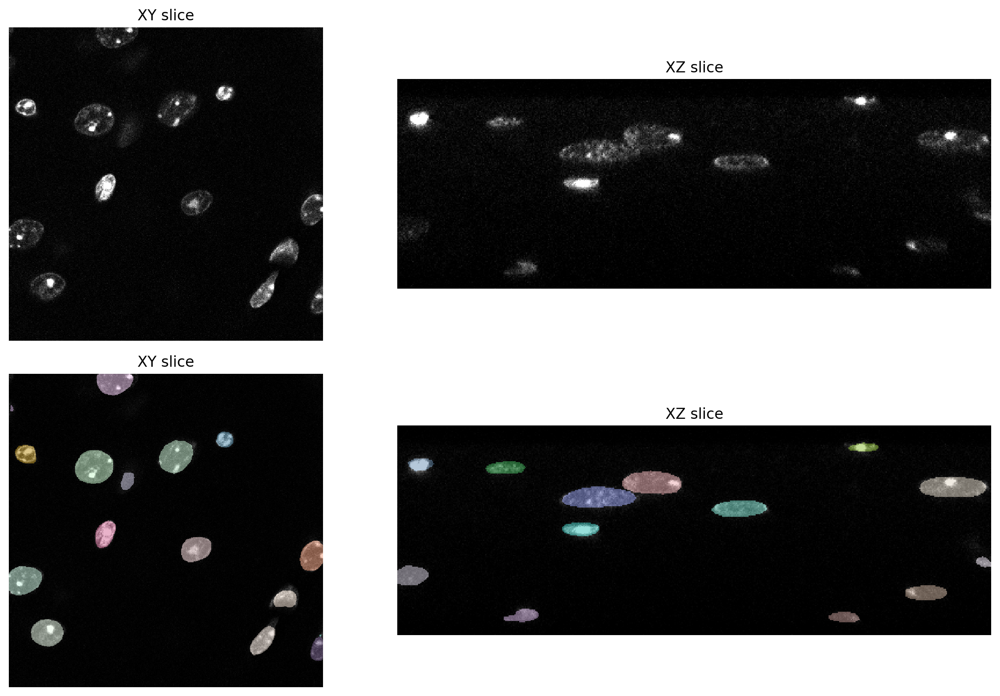

In [9]:
for i in range(len(X)):
    example(model,i)

In [45]:
import numpy as np
example(model,15)
point=np.zeros(X[15].shape)
for dot in details['points']:
    point[dot[0]-2:dot[0]+3,dot[1]-2:dot[1]+3,dot[2]-2:dot[2]+3]=255
io.imsave('point.tif',point)

2913475917.py (5): point.tif is a low contrast image


In [48]:
for i in details['points']:
    print(str(i))
print(str(details['points']))

[ 31 404 232]
[ 45 332 240]
[ 37 388 286]
[ 80 272  84]
[ 43 186  96]
[ 75 380 144]
[ 28 362 164]
[ 42 220 276]
[ 38 244  52]
[ 28 318  36]
[ 64 186 240]
[ 60 488 138]
[70 82 36]
[ 53 190 312]
[ 34 200 348]
[ 74 340  96]
[ 93 368  44]
[ 29 112 310]
[107 242 432]
[ 24  96 236]
[ 91 460  68]
[ 68 456 176]
[ 95 422 220]
[ 34 352 104]
[86 40 92]
[ 51 120 260]
[ 28 424 124]
[114  58  60]
[ 24 288 252]
[ 58 330 172]
[ 55 348  72]
[ 47 170 150]
[ 56 108 314]
[ 59 444  42]
[ 50 194  40]
[ 26 404 388]
[ 52 242 230]
[62 50 88]
[ 26 256 108]
[ 28 350 444]
[100 248  50]
[ 24 380  56]
[ 88 302  32]
[ 36 276 160]
[ 76  44 156]
[ 35 472  54]
[ 59 240 100]
[46 66 40]
[ 46 102 192]
[ 63  28 282]
[72 22 32]
[ 40 418 180]
[ 64 306 132]
[ 48  76 380]
[111 116  36]
[ 70 408  76]
[ 52 388 224]
[ 39  40 232]
[ 50 492 234]
[ 66  74 216]
[106 424  60]
[ 23  58 200]
[ 75 432 120]
[ 50  32 196]
[ 77 304 198]
[ 67 296 280]
[ 26 492 358]
[ 96 166 132]
[ 34 464 290]
[ 84 262 194]
[ 23 440 348]
[ 52 394  18]
[ 96 16

In [10]:
#example(model, 0)

In [11]:
#example(model, 1)

In [12]:
#example(model, 2)